In [ ]:
# Standard library
import os
import re
from collections import defaultdict, OrderedDict
from datetime import datetime

# Third-party
from spectral import *
from spectral import envi
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import pandas as pd

# VIS-NIR processing modules
import sys
sys.path.insert(0, 'VIS-NIR utils')

from rgb_utils import coerce_wavelengths, nearest_band_indices, rgb_from_bands
from white_reference import apply_white_reference_memmap
from band_utils import ensure_rcb, slice_by_wavelength
from savgol_utils import savgol_smooth_cube_stream
from ndvi import band_index_for_wavelength, ndvi_mask
from postprocessing import postprocess_binary_mask
from spectrum import average_spectrum_stream, average_by_treatment


## Reading files


In [ ]:
# Folder containing all .hdr files (no date subfolders)
folder_path = r"D:\hyperspectral\Nora\exp4"

# Data structures: nested dicts
data_dict = {}           # date -> {label -> (H, W, B) data (memmap-like)}
wavelengths_dict = {}    # date -> {label -> list[float] wavelengths}
loaded_files = 0

print(f"\n=== Scanning folder: {folder_path} ===")

for file in os.listdir(folder_path):
    # Only consider ENVI headers
    if not file.endswith('.hdr'):
        continue

    hdr_path = os.path.join(folder_path, file)
    base_name = os.path.splitext(file)[0]  # remove .hdr

    # ---- EXCLUDE any file that has 'SWIR' in its name ----
    if 'SWIR' in base_name.upper():
        print(f"  Skipping (SWIR): {file}")
        continue

    # Split filename into parts
    # Split filename into parts
    parts = base_name.split('_')
    if len(parts) < 2:
        print(f"  Skipping (unexpected name): {file}")
        continue

    # Extract date from the last part (e.g. "280225-20" → "280225")
    raw_date = parts[-1]
    date = raw_date.split('-')[0]

    # Cut off everything starting from "_exp3" or "_exp4" etc.
    cut_index = base_name.find("_exp3")
    if cut_index == -1:
        cut_index = base_name.find("_exp4")

    if cut_index != -1:
        label = base_name[:cut_index]
    else:
        # fallback: remove just the date part
        label = '_'.join(parts[:-1])

    # Compose expected .raw filename
    raw_file = base_name + '.raw'
    raw_path = os.path.join(folder_path, raw_file)

    # Skip if .hyspex binary exists
    hyspex_file = base_name + '.hyspex'
    hyspex_path = os.path.join(folder_path, hyspex_file)
    if os.path.exists(hyspex_path):
        print(f"  Skipping (has .hyspex binary): {file}")
        continue

    if not os.path.exists(raw_path):
        print(f"  Missing VNIR .raw binary for: {file}")
        continue

    try:
        # Open ENVI dataset
        img = envi.open(hdr_path, image=raw_path)
        meta = img.metadata

        # Parse wavelengths
        wl = []
        for w in meta.get("wavelength", []):
            try:
                wl.append(float(str(w).strip()))
            except Exception:
                pass

        data = img.open_memmap(interleave='source', writable=False)

        # Add to nested dict
        data_dict.setdefault(date, {})[label] = data
        wavelengths_dict.setdefault(date, {})[label] = wl
        loaded_files += 1

        print(f"  Loaded: {label} (date: {date})  (bands: {len(wl) if wl else 'unknown'})")

    except Exception as e:
        print(f"  Error loading {file}: {e}")

print(f"\n=== Done. Loaded {loaded_files} cube(s). ===")



=== Scanning folder: D:\hyperspectral\Nora\exp4 ===
  Loaded: clean_kontroll_sample1 (date: 280325)  (bands: 800)
  Loaded: clean_kontroll_sample1 (date: 020425)  (bands: 800)
  Loaded: clean_kontroll_sample1 (date: 040425)  (bands: 800)


C:\Users\HyperSpectral\AppData\Roaming\Python\Python313\site-packages\spectral\io\envi.py:187: UserWarning: Parameters with non-lowercase names encountered and converted to lowercase. To retain source file parameter name capitalization, set spectral.settings.envi_support_nonlowercase_params to True.
  warnings.warn(msg)


  Loaded: clean_kontroll_sample1 (date: 310325)  (bands: 800)
  Skipping (SWIR): clean_kontroll_sample1_exp3_and_4_SWIR_384_SN3151_2000us_2025-04-02T104704_raw.hdr
  Skipping (SWIR): clean_kontroll_sample1_exp3_and_4_SWIR_384_SN3151_2000us_2025-04-04T111504_raw.hdr
  Skipping (SWIR): clean_kontroll_sample1_exp3_and_4_SWIR_384_SN3151_2197us_2025-03-31T125835_raw.hdr
  Skipping (SWIR): clean_kontroll_sample1_exp3_and_4_SWIR_384_SN3151_2292us_2025-03-28T113654_raw.hdr
  Loaded: clean_kontroll_sample2 (date: 280325)  (bands: 800)
  Loaded: clean_kontroll_sample2 (date: 020425)  (bands: 800)
  Loaded: clean_kontroll_sample2 (date: 040425)  (bands: 800)
  Loaded: clean_kontroll_sample2 (date: 310325)  (bands: 800)
  Skipping (SWIR): clean_kontroll_sample2_exp3_and_4_SWIR_384_SN3151_2000us_2025-04-02T104857_raw.hdr
  Skipping (SWIR): clean_kontroll_sample2_exp3_and_4_SWIR_384_SN3151_2000us_2025-04-04T111808_raw.hdr
  Skipping (SWIR): clean_kontroll_sample2_exp3_and_4_SWIR_384_SN3151_2197us_20

In [9]:
wavelengths = wavelengths_dict["280325"]["clean_kontroll_sample1"]

In [13]:
# Rename dict keys
# Mapping of old -> new keys
rename_map = {
    "clean_kontroll_sample1": "clean_control_sample1",
    "clean_kontroll_sample2": "clean_control_sample2",
    "clean_tork_sample1": "clean_drought_sample1",
    "clean_tork_sample2": "clean_drought_sample2",
}

def rename_keys_in_nested_dict(d, mapping):
    """Renames keys in-place in a nested dict like {date: {label: value}}"""
    for date, inner in d.items():
        new_inner = {}
        for k, v in inner.items():
            new_k = mapping.get(k, k)  # use mapped name if exists
            new_inner[new_k] = v
        d[date] = new_inner

# Apply to both data_dict and wavelengths_dict
rename_keys_in_nested_dict(data_dict, rename_map)
rename_keys_in_nested_dict(wavelengths_dict, rename_map)

## Plotting RGB images

In [10]:
# Reshape from (R, B, C) to (R, C, B)
for date, date_dict  in data_dict.items():
    for key, mm in date_dict.items():
        if mm.shape[1] == len(wavelengths) and mm.ndim == 3:
            new_mm = np.moveaxis(mm, 1, 2)  # (B,R,C) -> (R,C,B)
            data_dict[date][key] = new_mm


In [ ]:
def _parse_ddmmyy(s: str):
    # robust: use the first 6 digits as DDMMYY
    s6 = ''.join(ch for ch in s if ch.isdigit())[:6]
    return datetime.strptime(s6, "%d%m%y")

def sort_nested_dict_by_date(d: dict, ascending=True):
    items = list(d.items())
    items.sort(key=lambda kv: _parse_ddmmyy(kv[0]), reverse=not ascending)
    return OrderedDict(items)  # or just dict(...) in Py3.7+ if you prefer

# Use ascending=True to get 280325 first, 040425 last
data_dict = sort_nested_dict_by_date(data_dict, ascending=True)
wavelengths_dict = sort_nested_dict_by_date(wavelengths_dict, ascending=True)

# sanity check
print(list(data_dict.keys()))


['280325', '310325', '020425', '040425']


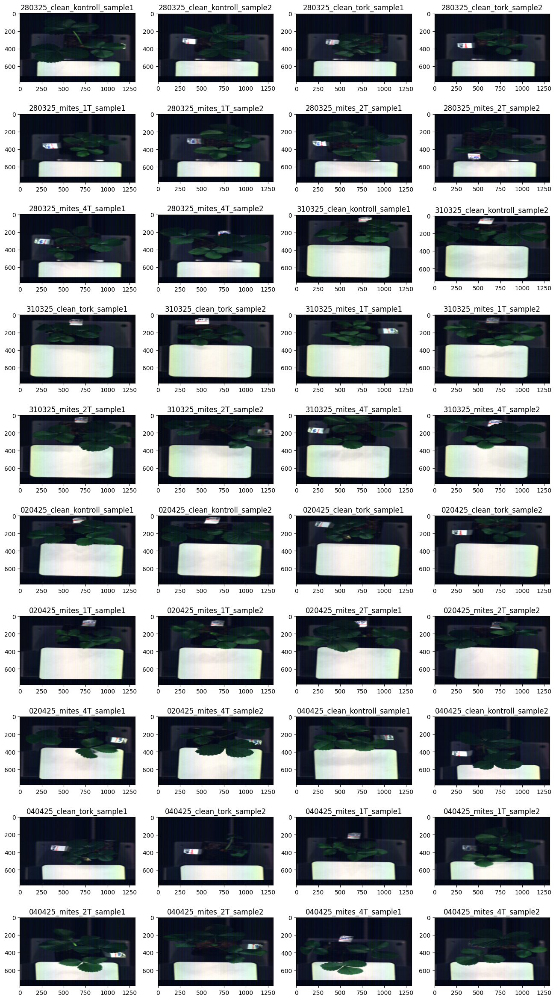

In [12]:
# Plotting the RGB images

targets = [650, 550, 470]  # R, G, B in nm
band_idx, actual_nm = nearest_band_indices(wavelengths, targets)

fig, axes = plt.subplots(10, 4, figsize=(16,30))
ax = axes.flatten()
j = 0
for i, (date, date_dict) in enumerate(data_dict.items()):
    for key, mm in date_dict.items():
        # 2) Build display RGB (keeps memory low; only 3 bands are touched)
        rgb = rgb_from_bands(mm, band_idx, clip_percent=(2, 98))

        ax[j].imshow(rgb)
        ax[j].set_title(f"{date}_{key}")
        j+=1





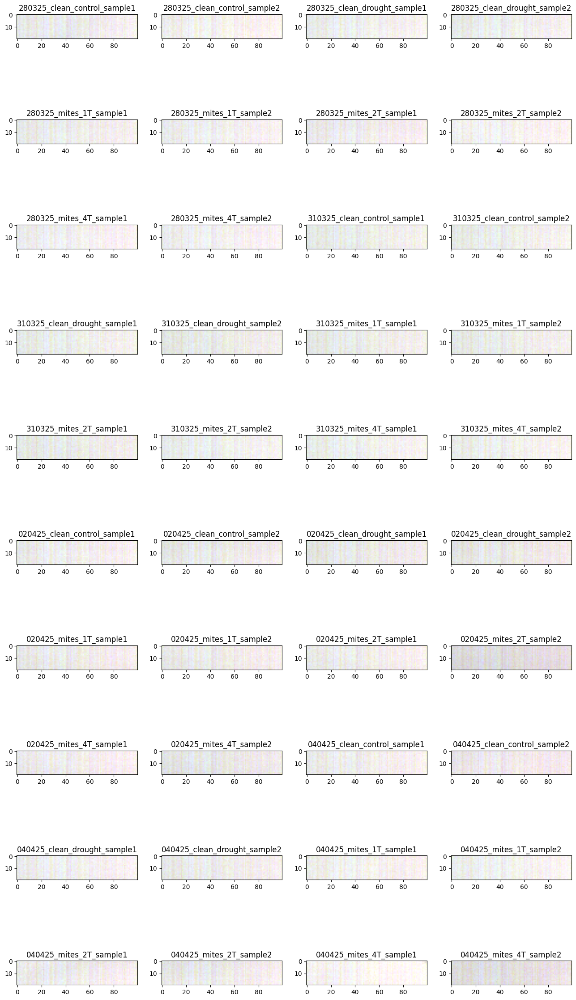

In [33]:
# Check white reference indices, so that no plant is present in that slice
fig, axes = plt.subplots(10, 4, figsize=(16,30))
ax = axes.flatten()
j = 0
for i, (date, date_dict) in enumerate(data_dict.items()):
    for key, mm in date_dict.items():
        # 2) Build display RGB (keeps memory low; only 3 bands are touched)
        rgb = rgb_from_bands(mm, band_idx, clip_percent=(2, 98))

        ax[j].imshow(rgb[640:660, 400:500])
        ax[j].set_title(f"{date}_{key}")
        j+=1



## White referencing

In [16]:
white_dict = {}
base_out_dir = r"D:\hyperspectral\Vis-NIR\temp"
for date, date_dict in data_dict.items():
  for key, mm_in in date_dict.items():
    # Create output memmap (float32 reflectance)
    out_filename = f"memmap_exp4_{date}_{key}_whiteref.npy"
    out_path = os.path.join(base_out_dir, out_filename)
    out = np.memmap(out_path, mode='w+', dtype=np.float32, shape=mm_in.shape)
    # White patch at rows 100–200, cols 50–150
    apply_white_reference_memmap(mm_in, (640, 660), (400, 500), out=out, dtype_out=np.float32)
    white_dict.setdefault(date, {})[key] = out
    # Before correction
 


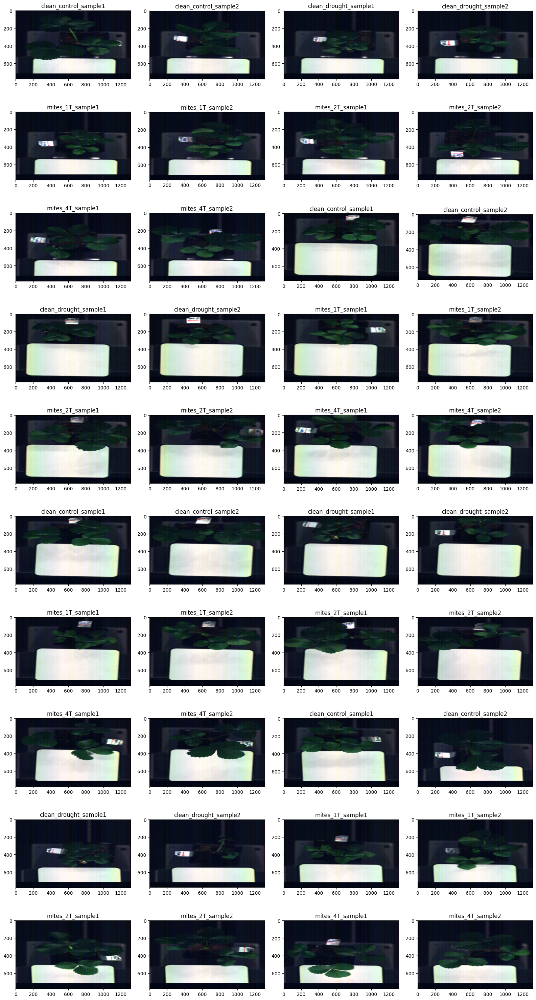

In [35]:
fig, axes = plt.subplots(10, 4, figsize=(16,30))
ax = axes.flatten()
i = 0

for date, date_dict in white_dict.items():
    for key, mm in date_dict.items():
    # 2) Build display RGB (keeps memory low; only 3 bands are touched)
        rgb = rgb_from_bands(mm, band_idx, clip_percent=(2, 98))

        ax[i].imshow(rgb)
        ax[i].set_title(key)
        i += 1

plt.tight_layout()
plt.show()



## Removing bands at sensor limit

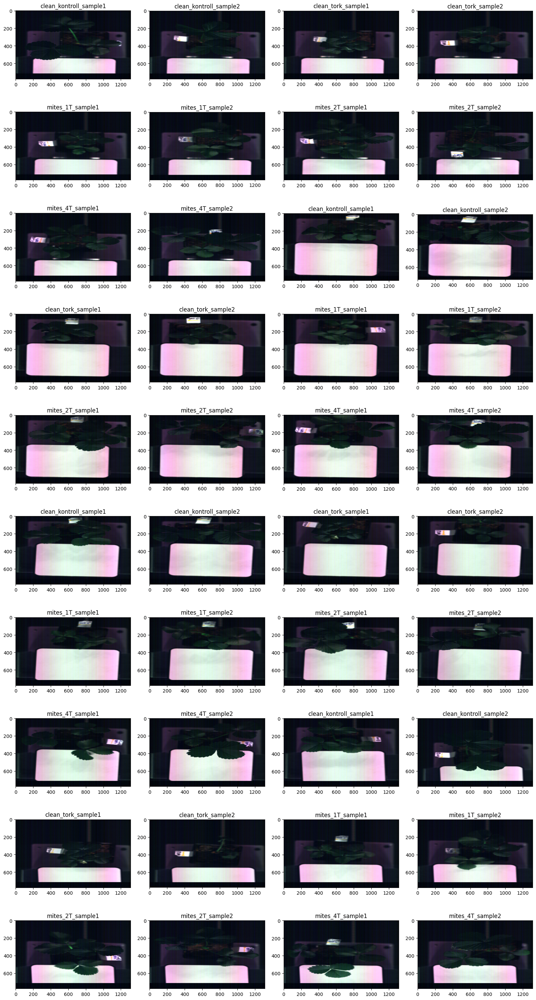

In [17]:
new_wavelengths = []
new_dict = {}
fig, axes = plt.subplots(10, 4, figsize=(16,30))
ax = axes.flatten()
i = 0

for date, date_dict in white_dict.items():
  for key, mm in date_dict.items():
    cube_rcb, wl_subset, band_slice = slice_by_wavelength(mm, wavelengths, min_nm=420, max_nm=950)
    white_dict.setdefault(date, {})[key] = cube_rcb
    new_wavelengths = wl_subset
    
    rgb = rgb_from_bands(cube_rcb, band_idx, clip_percent=(2, 98))
    ax[i].imshow(rgb)
    ax[i].set_title(key)
    i += 1

plt.tight_layout()
plt.show()


## Savitzky–Golay smoothing

In [18]:
base_out_dir = r"D:\hyperspectral\Vis-NIR\temp"
smooth_dict = {}
for date, date_dict in white_dict.items():
  for key, mm_in in date_dict.items():
  # Create an output memmap with the same shape but float32
    os.makedirs(base_out_dir, exist_ok=True)
    out_filename = f"memmap_exp4_{date}_{key}_smooth.npy"
    out_path = os.path.join(base_out_dir, out_filename)
    out = np.memmap(out_path, mode='w+', dtype=np.float32, shape=mm_in.shape)

    sg = savgol_smooth_cube_stream(
        mm_in, window_length=17, polyorder=3, axis=None,  # or axis=2 if you know it
        dtype_out=np.float32, tile_rows=256, out=out
    )
    smooth_dict.setdefault(date, {})[key] = out
  # `sg` is the same as `out`




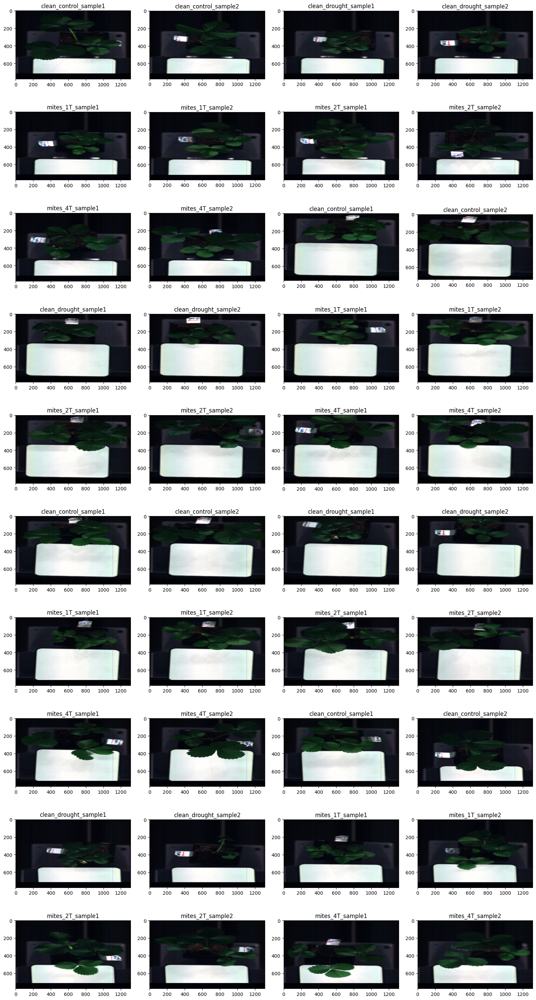

In [38]:
fig, axes = plt.subplots(10, 4, figsize=(16,30))
ax = axes.flatten()
targets = [650, 550, 470]  # R, G, B in nm
band_idx, actual_nm = nearest_band_indices(new_wavelengths, targets)
i = 0
for date, date_dict in smooth_dict.items():
    for key, mm in date_dict.items():
    # 2) Build display RGB (keeps memory low; only 3 bands are touched)
        rgb = rgb_from_bands(mm, band_idx, clip_percent=(2, 98))

        ax[i].imshow(rgb)
        ax[i].set_title(key)
        i += 1

plt.tight_layout()
plt.show()



## NDVI

C:\Users\HyperSpectral\AppData\Local\Temp\ipykernel_39888\1449337179.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 12))


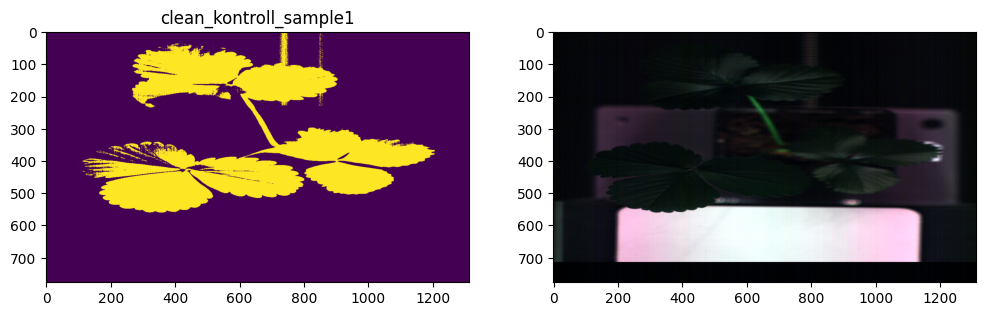

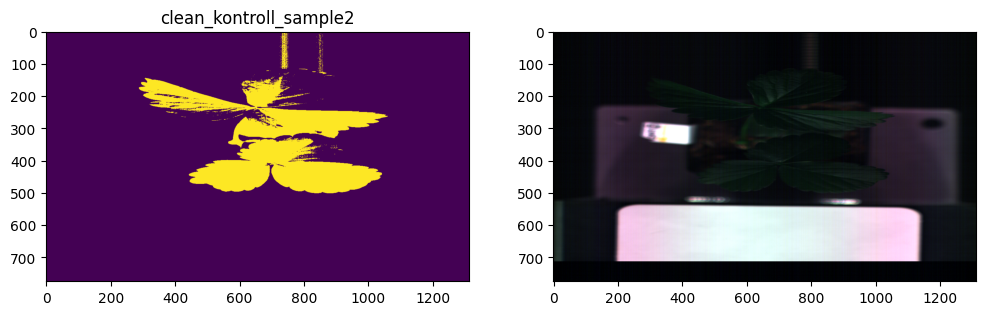

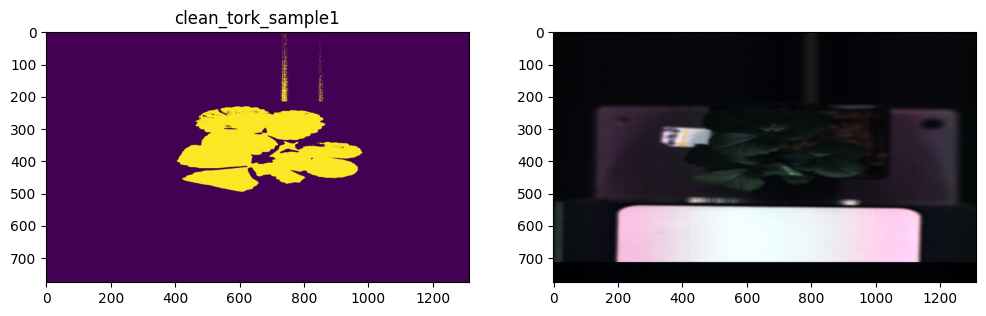

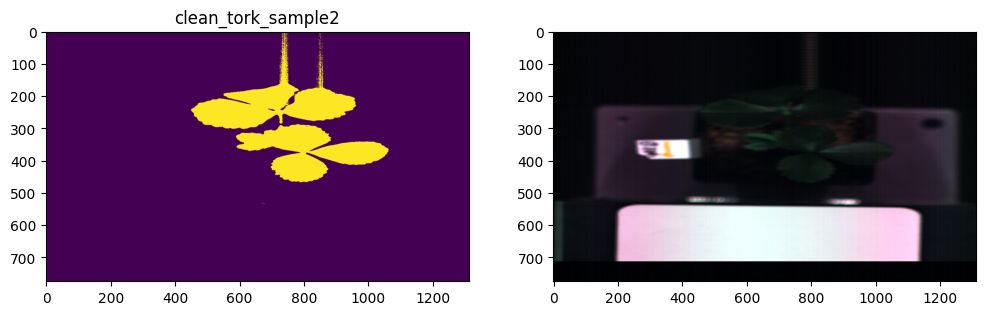

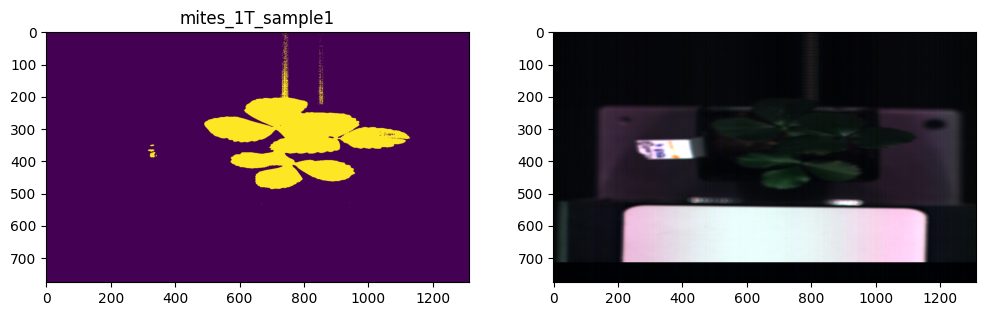

...

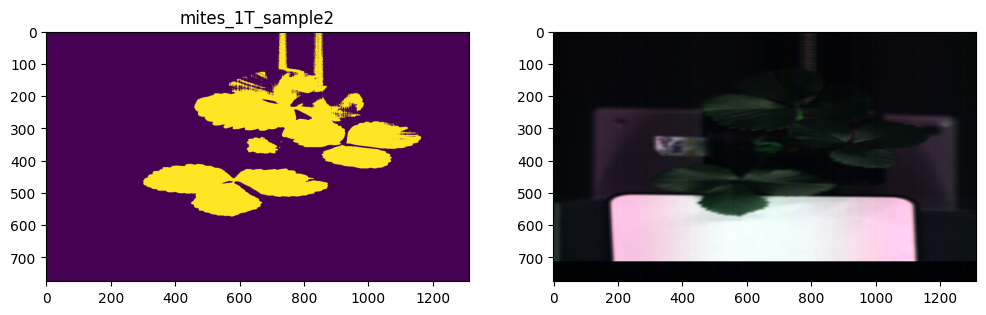

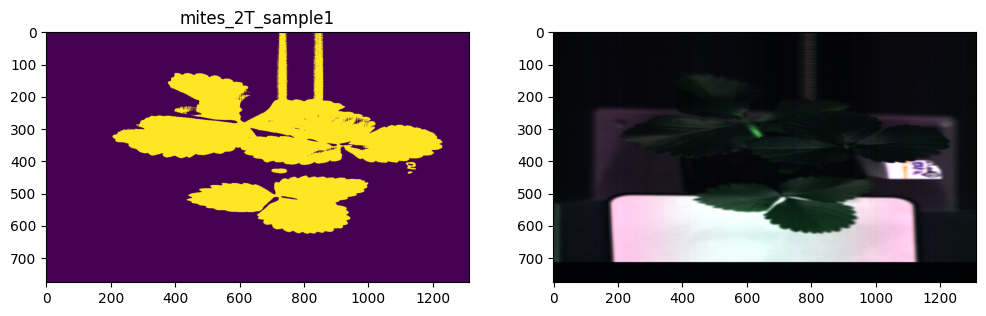

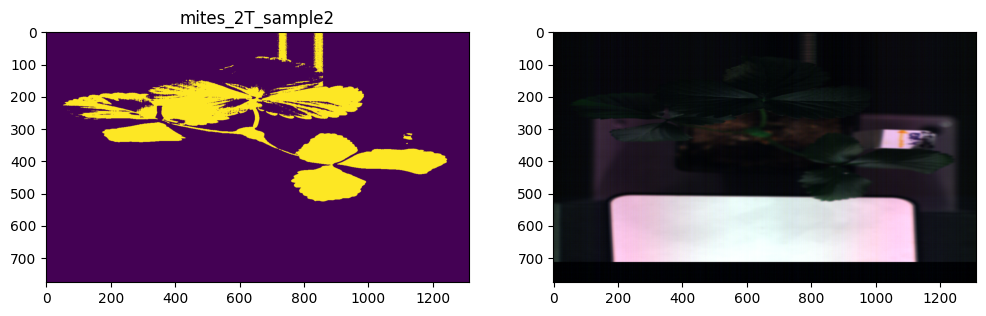

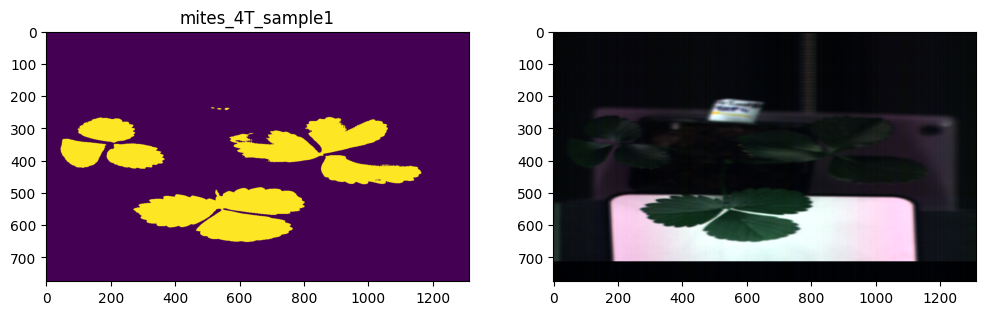

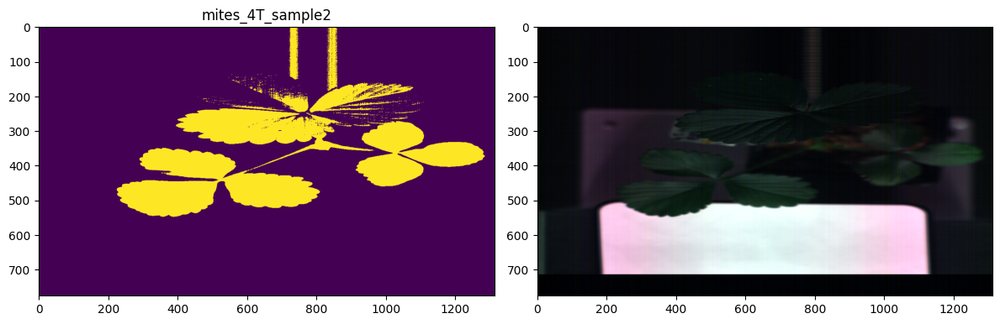

In [19]:
mask_dict = {}
for date, date_dict in smooth_dict.items():
    for key, cube_norm in date_dict.items():
        ndvi, mask = ndvi_mask(cube_norm, new_wavelengths, red_nm=670, nir_nm=800, thresh=0.25)
        mask_dict.setdefault(date, {})[key] = mask
        plt.figure(figsize=(12, 12))
        plt.subplot(1, 2, 1)
        plt.imshow(mask)
        plt.title(key)
        plt.subplot(1, 2, 2)
        rgb = rgb_from_bands(cube_norm, band_idx, clip_percent=(2, 98))
        plt.imshow(rgb)
plt.tight_layout()
plt.show()

# Save NDVI as grayscale image and mask as binary
#from PIL import Image
#Image.fromarray(((ndvi+1)/2*255).astype(np.uint8)).save("ndvi.png")
#Image.fromarray(mask.astype(np.uint8)*255).save("ndvi_mask.png")


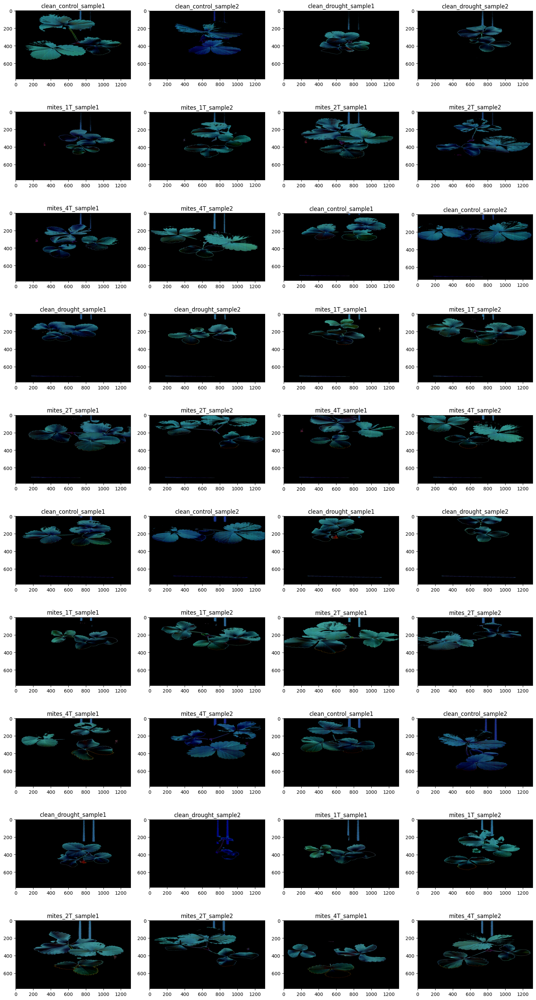

In [ ]:

fig, axes = plt.subplots(10, 4, figsize=(16,30))
ax = axes.flatten()
i = 0
for date, date_dict  in smooth_dict.items():
  for key, mm in date_dict.items():
    targets = [650, 550, 470]  # R, G, B in nm
    band_idx, actual_nm = nearest_band_indices(new_wavelengths, targets)
    rgb = rgb_from_bands(mm, band_idx, clip_percent=(2, 98))
    ax[i].imshow(rgb*mask_dict[date][key][:, :, None])
    ax[i].set_title(key)
    i += 1

plt.tight_layout()
plt.show()

 



## Post processing

C:\Users\HyperSpectral\AppData\Local\Temp\ipykernel_39888\590416901.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12, 12))


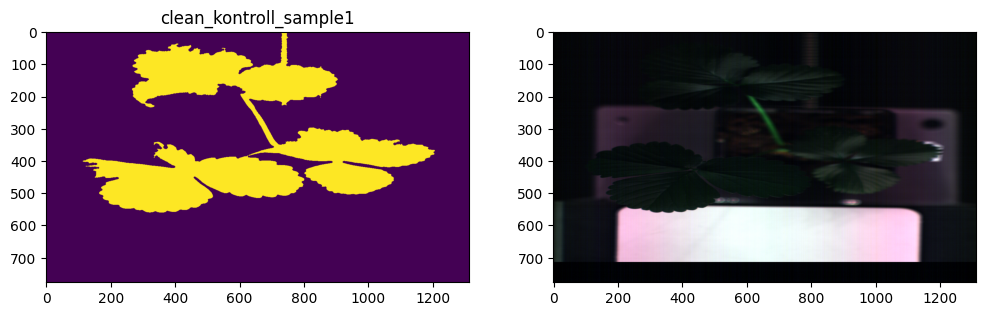

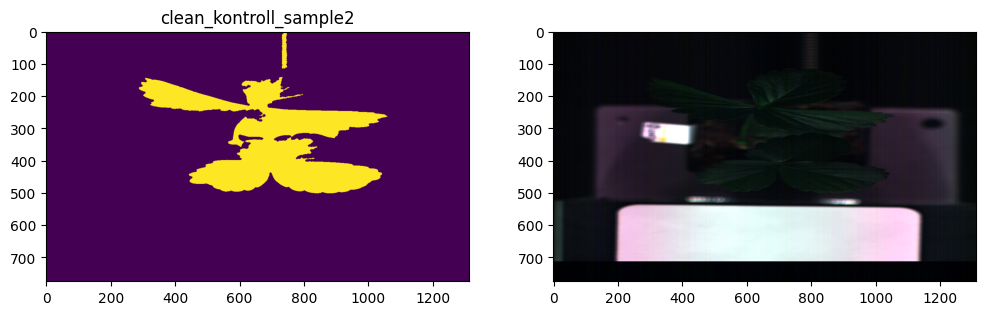

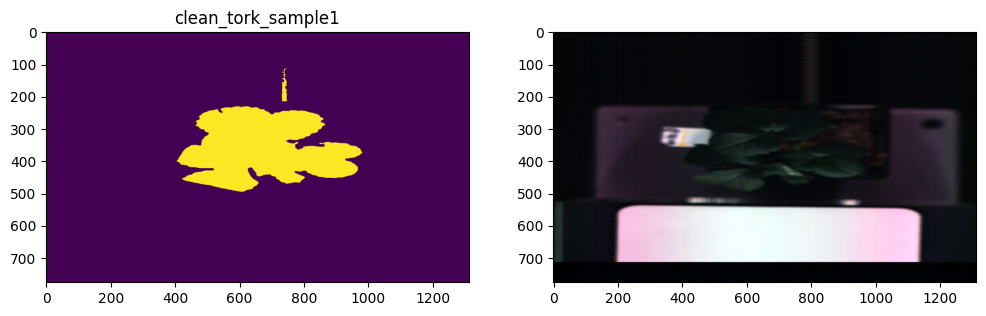

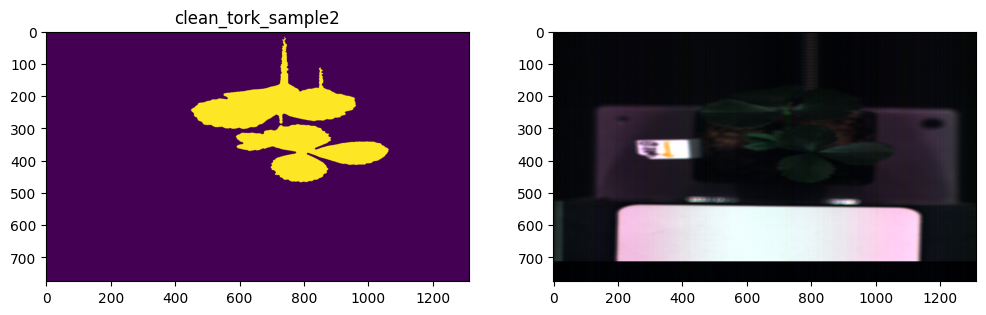

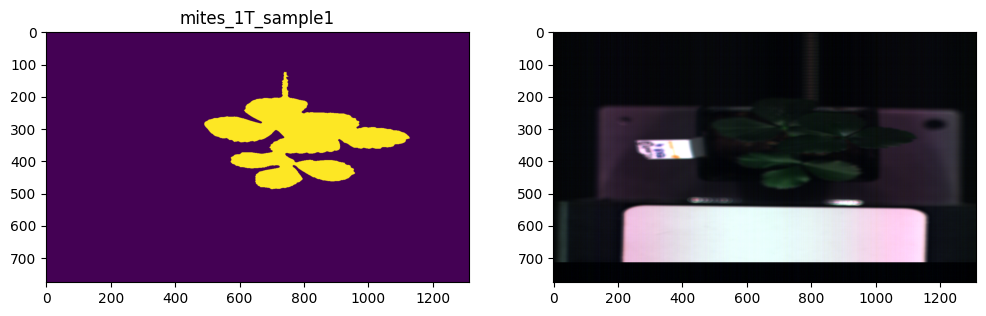

...

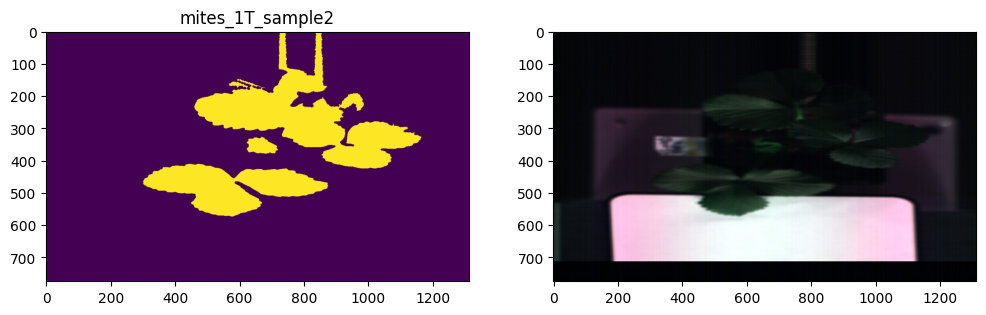

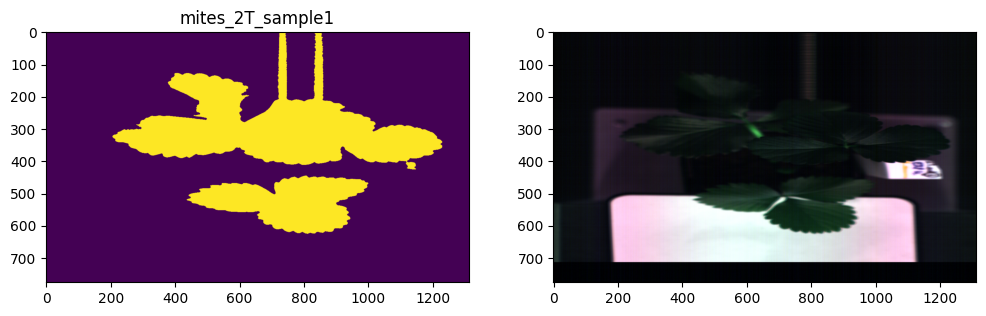

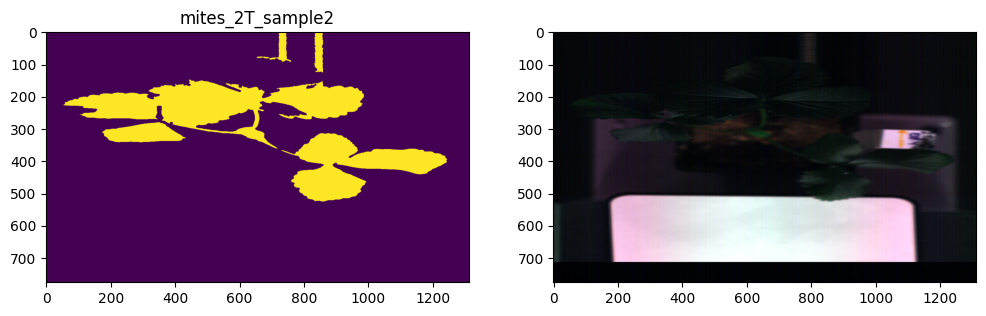

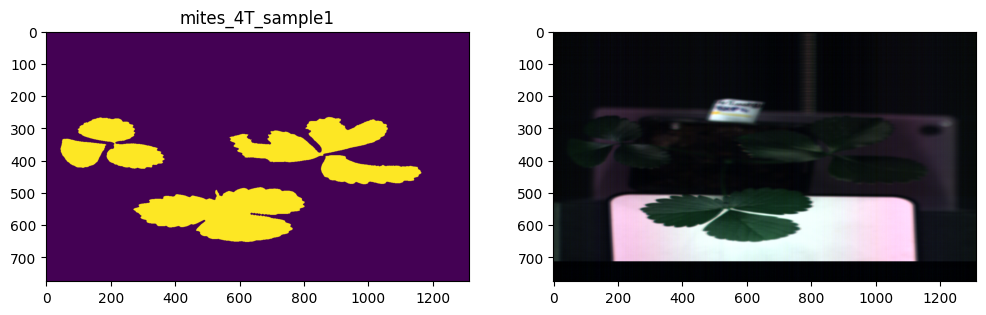

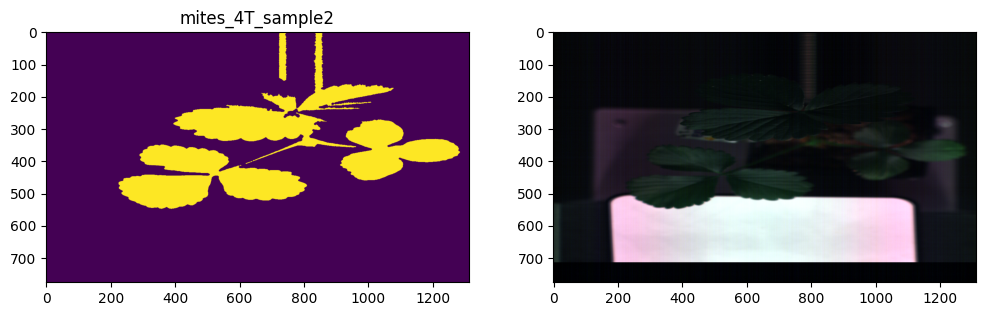

In [20]:
# ndvi_mask_bool: (H,W) bool from your NDVI step
# rgb_img_u8: (H,W,3) uint8 preview you already build for overlay (e.g., get_rgb())
clean_mask = {}
for date, date_dict in mask_dict.items():
  for key, mask in date_dict.items():
    clean = postprocess_binary_mask(mask, close_ks=7, open_ks=3,
                                    min_area=800, fill_holes=True)

    clean_mask.setdefault(date, {})[key] = clean
    plt.figure(figsize=(12, 12))
    plt.subplot(1, 2, 1)
    plt.imshow(clean)
    plt.title(key)
    plt.subplot(1, 2, 2)
    rgb = rgb_from_bands(smooth_dict[date][key], band_idx, clip_percent=(2, 98))
    plt.imshow(rgb)




In [21]:
base_out_dir = r"D:\hyperspectral\Vis-NIR\masked_images_exp4_clean"
masked_ims = {}
for date, date_dict in smooth_dict.items():
  for key, mm_in in date_dict.items():
  # Create an output memmap with the same shape but float32
    os.makedirs(base_out_dir, exist_ok=True)
    out_filename = f"masked_im_exp4_{date}_{key}.npy"
    out_path = os.path.join(base_out_dir, out_filename)
    masked = mm_in*clean_mask[date][key][:, :, None]
    out = np.memmap(out_path, mode='w+', dtype=np.float32, shape=masked.shape)
    out[:] = masked[:]

## Spectrum analysis

<Figure size 1600x1600 with 0 Axes>

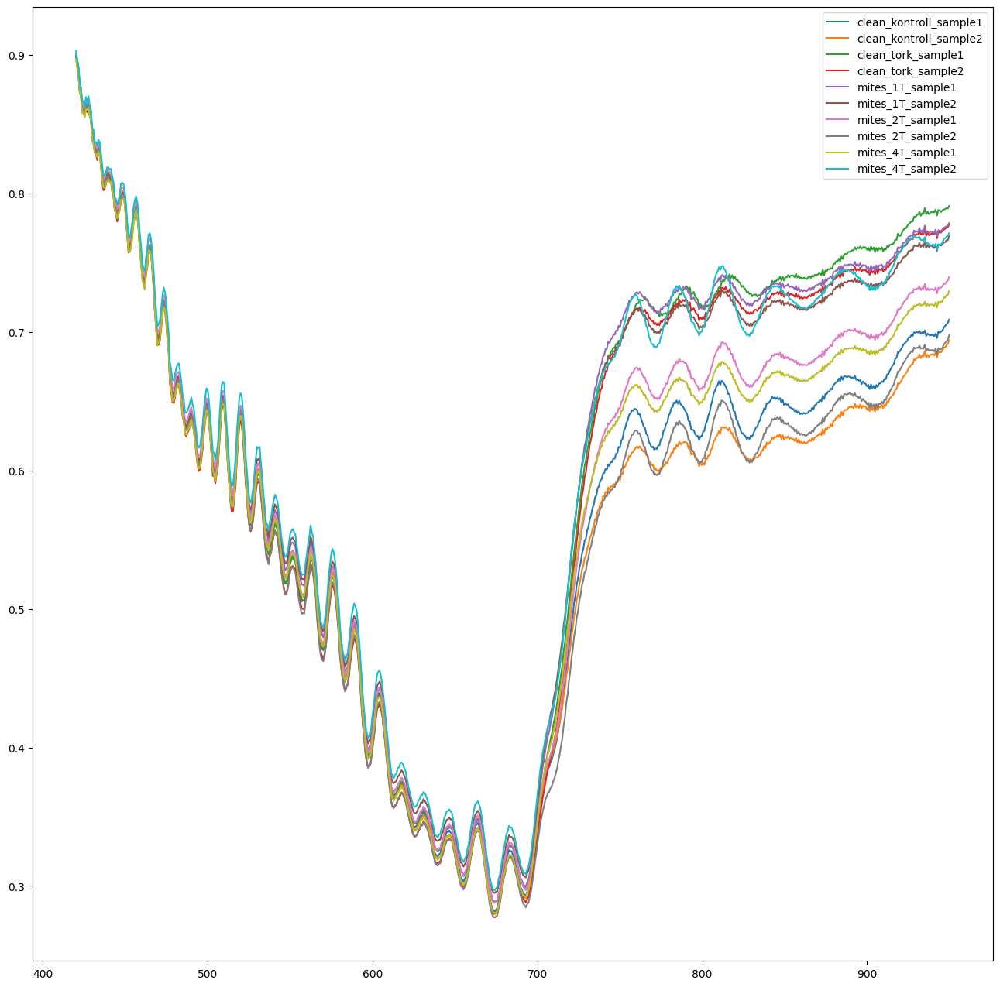

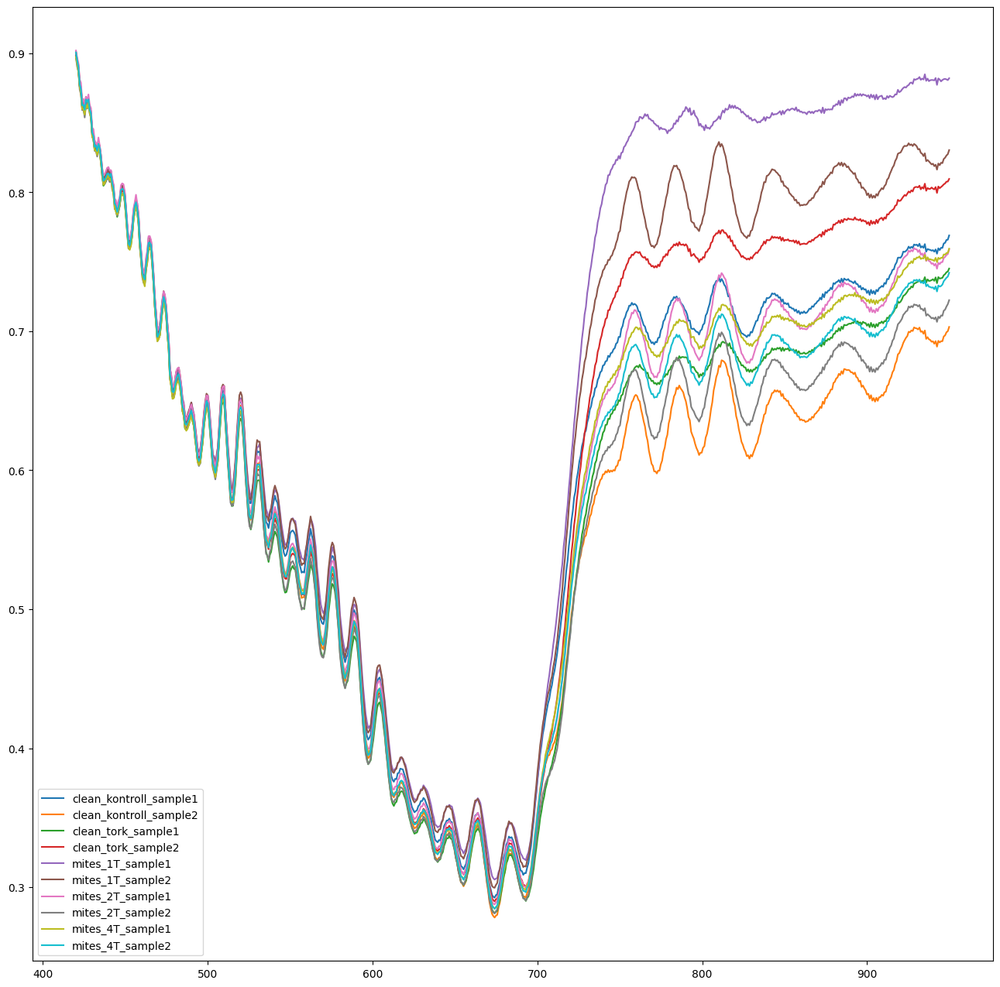

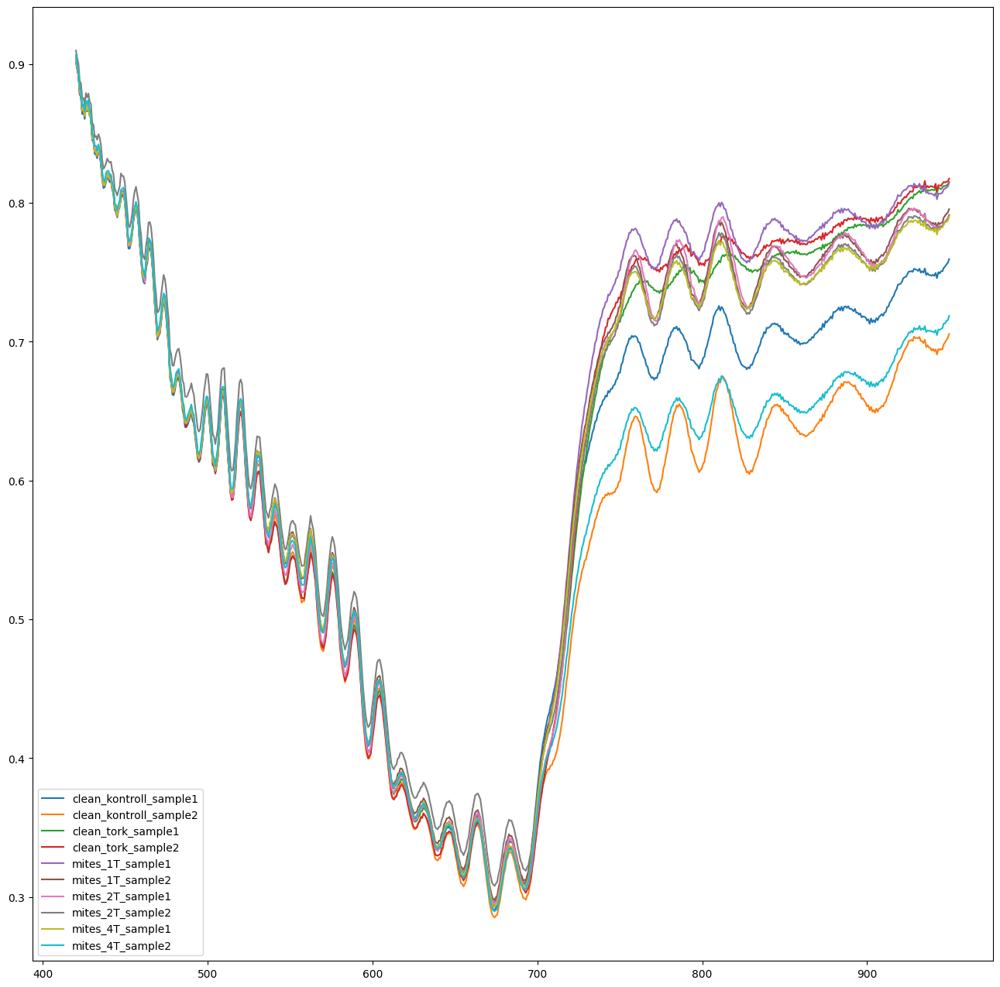

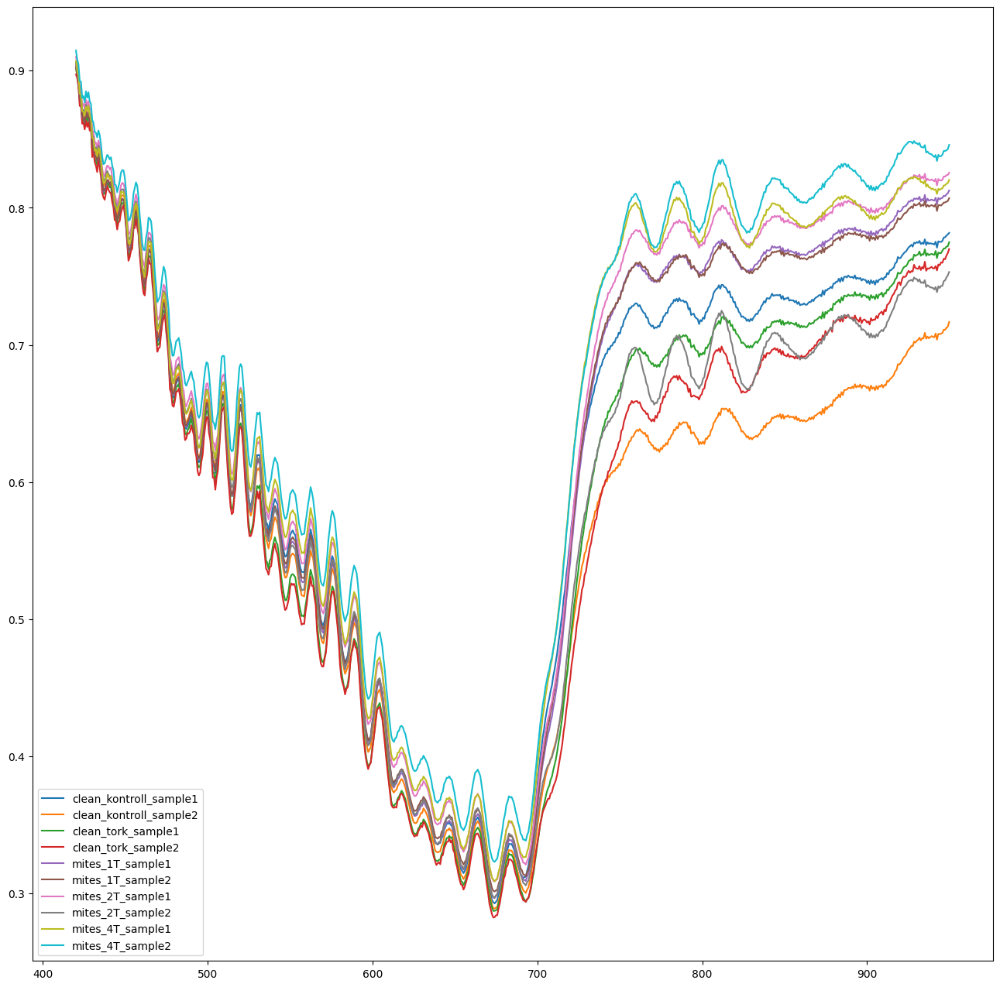

In [20]:
plt.figure(figsize=(16, 16))
mean_spec_dict = {}
for date, date_dict in white_dict.items():
  plt.figure(figsize=(16, 16))
  for key, mm in date_dict.items():
    mean_spec, std_spec, n_pix = average_spectrum_stream(mm, clean_mask[date][key])
    mean_spec_dict.setdefault(date, {})[key] = mean_spec
    plt.plot(new_wavelengths, mean_spec, label=key)
    plt.legend()

In [ ]:

# Example: all hyperspectral images stored as numpy arrays (height x width x bands)
# and wavelengths stored separately
  
for date, date_dict in mean_spec_dict.items():
    rows = []
    names = []
    for key, avg_spectrum in date_dict.items():
        rows.append(avg_spectrum)
        names.append(f"{key.lower()}_exp4_{date}")

    # Create DataFrame with wavelength names as columns
    df = pd.DataFrame(rows, columns=[f"{int(w)}nm" for w in new_wavelengths])
    df.insert(0, "image_id", [os.path.basename(f) for f in names])

    # (Optional) add labels if available
    # df["label"] = ["classA", "classB", ...]

    # Save to CSV
    df.to_csv(f"spectrums/raw_average_spectra_exp4_{date}.csv", index=False)
    print("✅ csv")

✅ csv
✅ csv
✅ csv
✅ csv


clean_control: (673,) (avg over 2 samples)
clean_drought: (673,) (avg over 2 samples)
mites_1T: (673,) (avg over 2 samples)
mites_2T: (673,) (avg over 2 samples)
mites_4T: (673,) (avg over 2 samples)


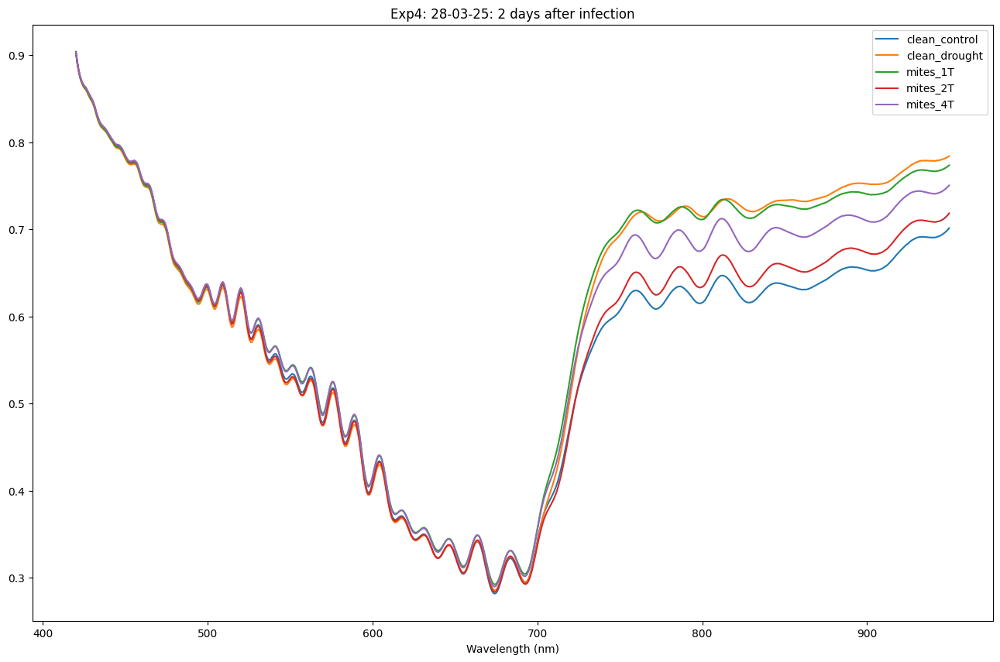

In [25]:

treat_dict = average_by_treatment(mean_spec_dict["280325"])
plt.figure(figsize=(16, 10))
for t, spec in treat_dict.items():
    print(f"{t}: {spec.shape} (avg over {len([k for k in mean_spec_dict["280325"] if k.startswith(t)])} samples)")
    plt.plot(new_wavelengths, spec, label=t)
    plt.legend()
    plt.title("Exp4: 28-03-25: 2 days after infection")
    plt.xlabel("Wavelength (nm)")
    plt.savefig(r"plots\exp4\visnir_exp4_280325.png")


In [35]:
treat_dict.keys()

dict_keys(['clean_control', 'clean_drought', 'mites_1T', 'mites_2T', 'mites_4T'])

clean_control: (673,) (avg over 2 samples)
clean_drought: (673,) (avg over 2 samples)
mites_1T: (673,) (avg over 2 samples)
mites_2T: (673,) (avg over 2 samples)
mites_4T: (673,) (avg over 2 samples)


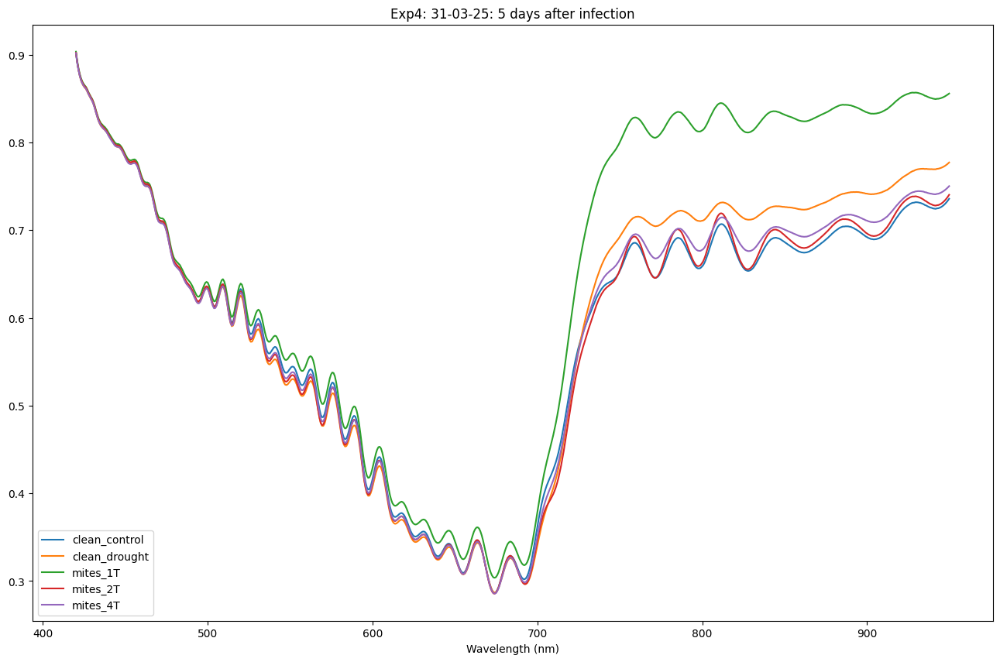

In [26]:

treat_dict = average_by_treatment(mean_spec_dict["310325"])
plt.figure(figsize=(16, 10))
for t, spec in treat_dict.items():
    print(f"{t}: {spec.shape} (avg over {len([k for k in mean_spec_dict["310325"] if k.startswith(t)])} samples)")
    plt.plot(new_wavelengths, spec, label=t)
    plt.legend()
    plt.xlabel("Wavelength (nm)")
    plt.title("Exp4: 31-03-25: 5 days after infection")
    plt.savefig(r"plots\exp4\visnir_exp4_310325.png")

clean_control: (673,) (avg over 2 samples)
clean_drought: (673,) (avg over 2 samples)
mites_1T: (673,) (avg over 2 samples)
mites_2T: (673,) (avg over 2 samples)
mites_4T: (673,) (avg over 2 samples)


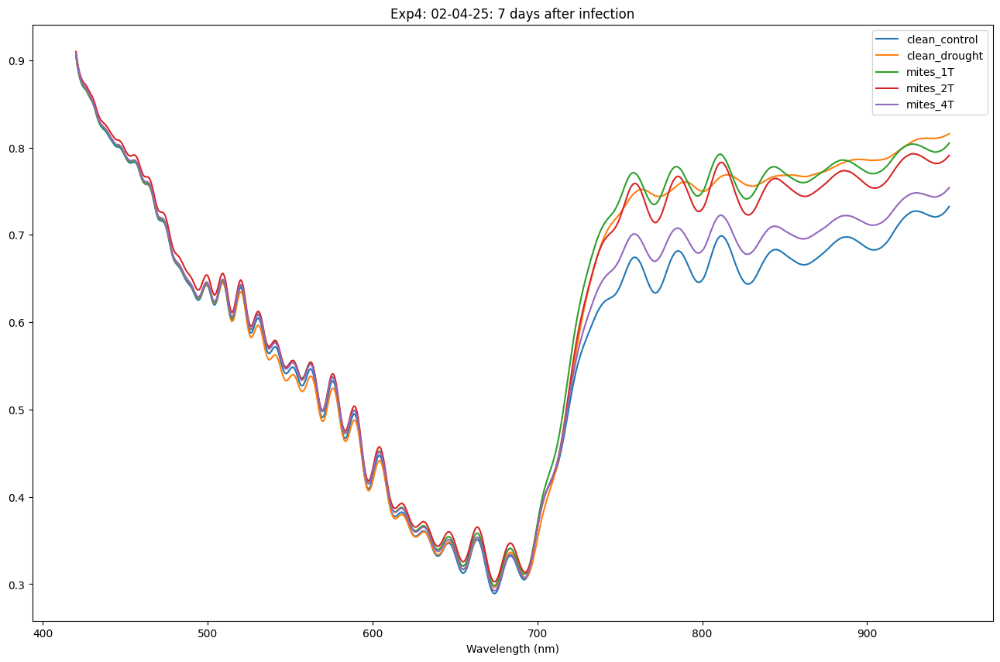

In [28]:

treat_dict = average_by_treatment(mean_spec_dict["020425"])
plt.figure(figsize=(16, 10))
for t, spec in treat_dict.items():
    print(f"{t}: {spec.shape} (avg over {len([k for k in mean_spec_dict["020425"] if k.startswith(t)])} samples)")
    plt.plot(new_wavelengths, spec, label=t)
    plt.legend()
    plt.xlabel("Wavelength (nm)")
    plt.title("Exp4: 02-04-25: 7 days after infection")
    plt.savefig(r"plots\exp4\visnir_exp4_020425.png")

clean_control: (673,) (avg over 2 samples)
clean_drought: (673,) (avg over 2 samples)
mites_1T: (673,) (avg over 2 samples)
mites_2T: (673,) (avg over 2 samples)
mites_4T: (673,) (avg over 2 samples)


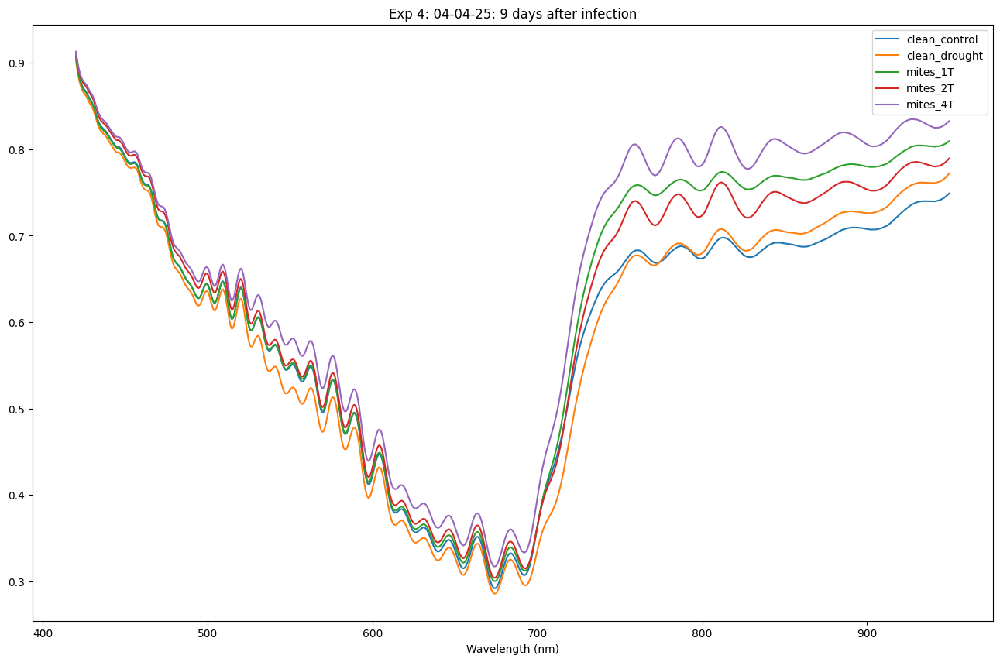

In [27]:

treat_dict = average_by_treatment(mean_spec_dict["040425"])
plt.figure(figsize=(16, 10))
for t, spec in treat_dict.items():
    print(f"{t}: {spec.shape} (avg over {len([k for k in mean_spec_dict["040425"] if k.startswith(t)])} samples)")
    plt.plot(new_wavelengths, spec, label=t)
    plt.legend()
    plt.xlabel("Wavelength (nm)")
    plt.title("Exp 4: 04-04-25: 9 days after infection")
    plt.savefig(r"plots\exp4\visnir_exp4_040425.png")